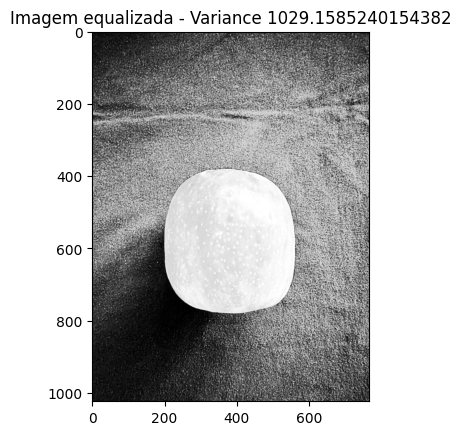

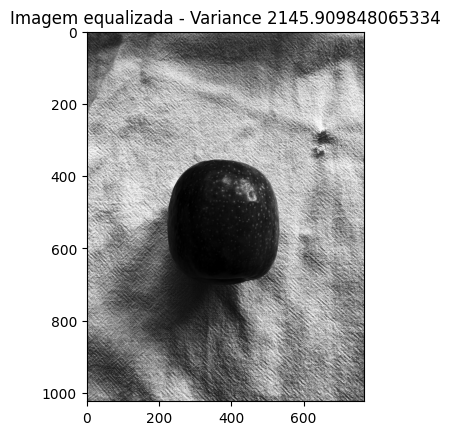

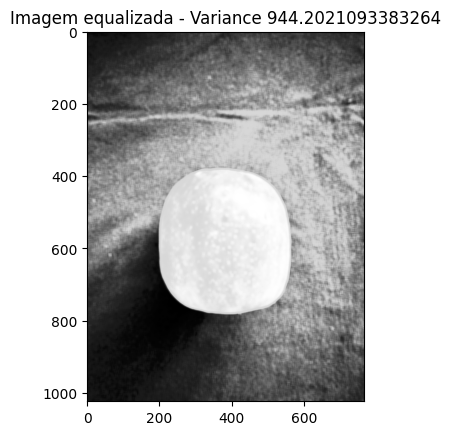

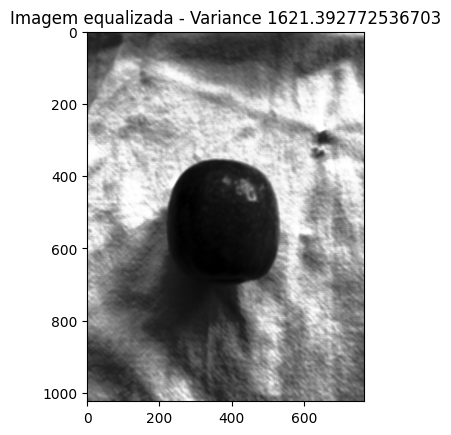

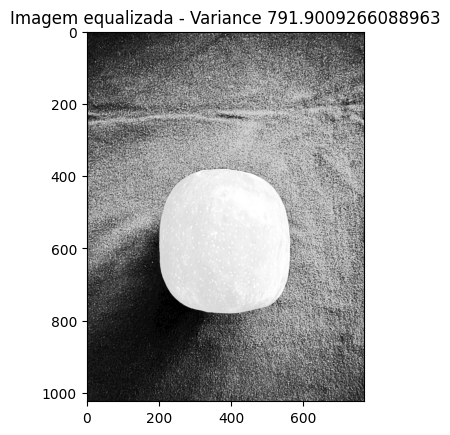

...

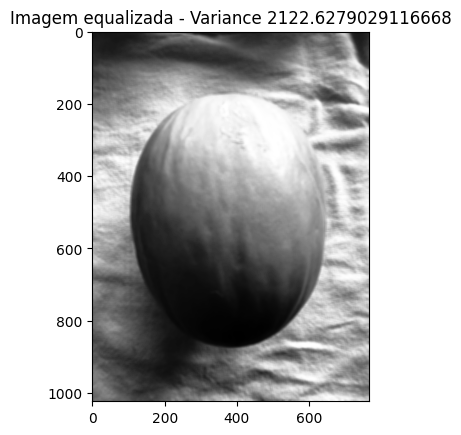

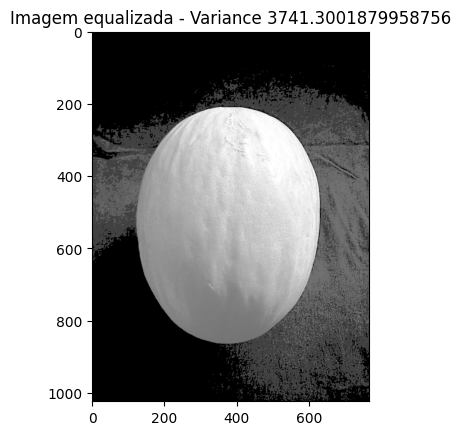

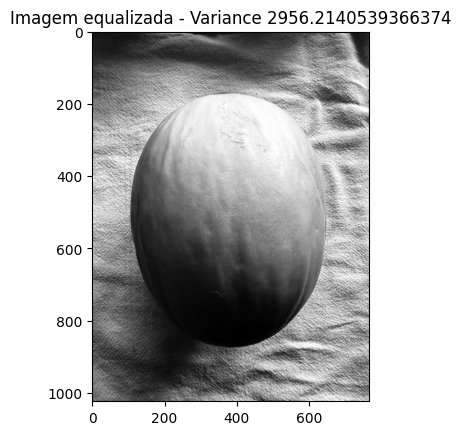

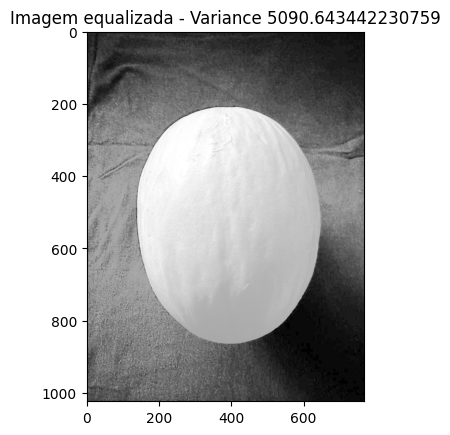

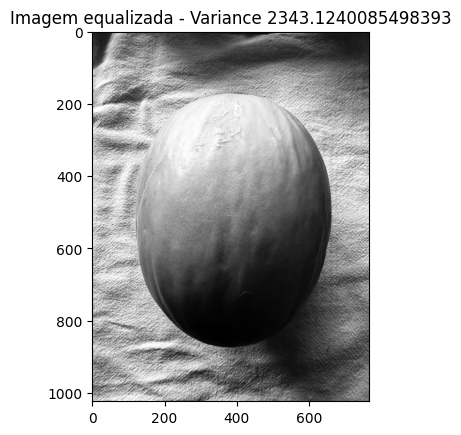

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import math

def read_image(filename):
    return cv2.imread(filename)

def equalize_image(filename):
    # Carrega a imagem em cores
    image = read_image(filename)

    # Converte a imagem para escala de cinza
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Equaliza o histograma
    equ = cv2.equalizeHist(gray)

    # Cálculo da variância
    imean = np.mean(gray)
    grayf = gray.astype(np.float32)
    grayf2 = grayf * grayf
    imeanf2 = np.mean(grayf2)
    ivar = imeanf2 - imean**2
    istd = math.sqrt(ivar)

    # Plota a imagem equalizada
    plt.title(f"Imagem equalizada - Variance {ivar}")
    plt.imshow(equ, cmap='gray')
    plt.show()

    # Obtém a classe da fruta a partir do nome do arquivo
    class_folder = os.path.basename(os.path.dirname(filename))

    # Cria uma nova pasta para a classe (se não existir)
    output_folder = os.path.join('ImagensEqualizadas', class_folder)
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Salva a imagem equalizada
    output_filename = os.path.join(output_folder, os.path.basename(filename))
    cv2.imwrite(output_filename, equ)

fruits = [('apple', '01'), ('banana', '02'), ('pineapple', '03'), ('orange', '04'), ('pear', '05'), ('kiwi_fruit', '06'), ('avocado', '07'), ('dragon_fruit', '08'), ('lemon', '09'), ('melon', '10')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'cnv', 'pot', 'mirror']
folder_original_images = 'FrutasProcessadas'

def get_image_paths(folder_path, fruit):
    image_paths = []
    for version in versions:
        for operation in operations:
            for color in colors:
                filename = '0-' + fruit[1] + '-' + version + '-' + color
                if operation:
                    filename += '-' + operation
                filename += '.png'
                image_path = os.path.join(folder_path, filename)
                image_paths.append(image_path)
    return image_paths

def process_images_in_folder(folder_path, fruit):
    image_paths = get_image_paths(folder_path, fruit)
    for image_path in image_paths:
        equalize_image(image_path)

# Caminho para as imagens originais
for fruit in fruits:
    fruit_folder = os.path.join(folder_original_images, fruit[0].capitalize())
    process_images_in_folder(fruit_folder, fruit)
